<a href="https://colab.research.google.com/github/Phalguni-Raju/NNDL/blob/main/rgb_to_grayscale_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

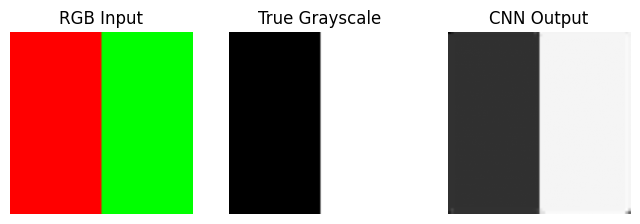

In [ ]:
import torch, torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt

# ----- create structured RGB image -----
rgb = np.zeros((64,64,3), dtype=np.float32)
rgb[:, :32, 0] = 1.0   # red block
rgb[:, 32:, 1] = 1.0   # green block

# ----- tensors -----
x = torch.tensor(rgb).permute(2,0,1).unsqueeze(0)   # (1,3,64,64)

# true grayscale (formula)
y = 0.299*x[:,0:1] + 0.587*x[:,1:2] + 0.114*x[:,2:3]

# ----- CNN -----
model = nn.Sequential(
    nn.Conv2d(3, 8, 3, padding=1),
    nn.ReLU(),
    nn.Conv2d(8, 1, 3, padding=1)
)

loss_fn = nn.MSELoss()
opt = torch.optim.Adam(model.parameters(), lr=0.01)

# ----- train -----
for _ in range(500):
    pred = model(x)
    loss = loss_fn(pred, y)
    opt.zero_grad()
    loss.backward()
    opt.step()

# ----- display -----
plt.figure(figsize=(8,4))

plt.subplot(1,3,1)
plt.title("RGB Input")
plt.imshow(rgb)
plt.axis("off")

plt.subplot(1,3,2)
plt.title("True Grayscale")
plt.imshow(y.squeeze().detach().numpy(), cmap="gray")
plt.axis("off")

plt.subplot(1,3,3)
plt.title("CNN Output")
plt.imshow(pred.squeeze().detach().numpy(), cmap="gray")
plt.axis("off")

plt.show()


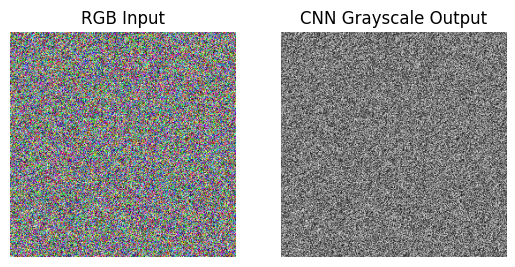

In [ ]:
import torch, torch.nn as nn
import torchvision.transforms as T
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# ----- generate RGB image -----
# Generate a random 256x256 RGB image with pixel values between 0 and 1
rgb = np.random.rand(256, 256, 3)

# Convert the numpy array to a PIL Image for further processing
rgb_img = Image.fromarray((rgb * 255).astype(np.uint8))

# ----- tensors -----
x = T.ToTensor()(rgb_img).unsqueeze(0)
y = T.Grayscale(1)(rgb_img)
y = T.ToTensor()(y).unsqueeze(0)

# ----- CNN -----
model = nn.Sequential(
    nn.Conv2d(3, 8, 3, padding=1),
    nn.ReLU(),
    nn.Conv2d(8, 1, 3, padding=1)
)

loss_fn = nn.MSELoss()
opt = torch.optim.Adam(model.parameters(), lr=0.01)

# ----- train -----
for _ in range(300):
    pred = model(x)
    loss = loss_fn(pred, y)
    opt.zero_grad()
    loss.backward()
    opt.step()

# ----- display -----
plt.subplot(1,2,1)
plt.title("RGB Input")
plt.imshow(rgb)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("CNN Grayscale Output")
plt.imshow(pred.squeeze().detach().numpy(), cmap="gray")
plt.axis("off")

plt.show()

cnn for body parts

In [ ]:
!pip install -q kagglehub


In [ ]:
from google.colab import files
files.upload()


Saving archive (5).zip to archive (5).zip


{'archive (5).zip': b'PK\x03\x04-\x00\x00\x00\x08\x00mE4Ta\xe2\x9c\x00\xff\xff\xff\xff\xff\xff\xff\xff$\x00\x14\x00Body Parts Dataset/Belly/Belly_1.jpg\x01\x00\x10\x00S\t\x00\x00\x00\x00\x00\x00\xbe\x08\x00\x00\x00\x00\x00\x00\x9d\x94WT\xd3[\x16\xc6\xff!\t\xa1\x06C\x91b\x02\x08b\xa8^J(\x01\x14A@\x8a\xd2\x9b ]\xa9\x16:\x12\x8a\x180j\xa4hTD\x84 \x01\xa4)\x97\x0e\xa1(HoB \x04\x10Az\x11\x19\x84\x08(^\xc9\xc0]sg^\xe6a\xe6~g}O{\xaf\xbd\xf6\xef\xec\xb3\x0fk\x8c5\r\x1c2365\x06@ \x00\x00\xed\x1f\x805\x01\x9c\x018\xd8\xd9a\xecP\x0e\x18\x0c\xc6\xc9\xc9\xc1\xc5#\xc8\xcb\xc3\xcd\xcd#\xca/\xc0\'\x88\x12\x93\x10G\x89!\x91\x92\xc7N\xa0%\xa5\x14\xa5\x91HYM9Ee\x15\x0c\x06#\x81\xc6\x9e\xd4R\xd5=\xa1\x86Q=(\x02\xe2\xe4\xe4\xe4\xe1\xe6\x11\xe1\xe5\x15Q=\x8a<\xaa\xfa\x7f\x8b\xd5\x0c 8\x80x \x1e\x0c\x92\x02\xd8\x10 0\x02\xc4j\x03$\xf6\xfb\x84\x82\xfe\x14\xf0/\x81\xd8\xc0\x10(;\x8c\x83\x93\x8b{?\xa1\xfa\x10\xc0\x06\x02\x83\xd9 `(\x14\x02\xd9\x8f\xc6\xee\xc7\x01\x08\x02\xca\x7fTE\x9f]\xc0\xda\x13&\x15,\xa8z\xe

In [ ]:
# ======================================================
# BODY PART IDENTIFICATION – ONE CELL ONLY
# MANUAL ZIP UPLOAD METHOD (COLAB SAFE)
# ======================================================

import zipfile, os, numpy as np, matplotlib.pyplot as plt, tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array

# ----------------------------
# 1. UNZIP DATASET
# ----------------------------
# Assuming the uploaded file is 'archive (5).zip'. If your uploaded file has a different name,
# please update this path accordingly.
ZIP_PATH = "/content/archive (5).zip" # Originally: "/content/body-parts-dataset.zip"
EXTRACT_PATH = "/content/body_parts"

with zipfile.ZipFile(ZIP_PATH, "r") as zip_ref:
    zip_ref.extractall(EXTRACT_PATH)

DATASET_PATH = EXTRACT_PATH + "/Body Parts Dataset"
print("Dataset folders:", os.listdir(DATASET_PATH))

# ----------------------------
# 2. CONFIG
# ----------------------------
IMG_SIZE = 224
BATCH_SIZE = 32
EPOCHS = 5

# ----------------------------
# 3. LOAD DATA
# ----------------------------
datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_data = datagen.flow_from_directory(
    DATASET_PATH,
    target_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    subset="training"
)

val_data = datagen.flow_from_directory(
    DATASET_PATH,
    target_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    subset="validation"
)

class_names = list(train_data.class_indices.keys())
print("Classes:", class_names)

# ----------------------------
# 4. PRETRAINED CNN
# ----------------------------
base_model = MobileNetV2(
    weights="imagenet",
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3)
)
base_model.trainable = False

model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(128, activation="relu"),
    Dropout(0.5),
    Dense(len(class_names), activation="softmax")
])

model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

model.summary()

# ----------------------------
# 5. TRAIN
# ----------------------------
model.fit(train_data, validation_data=val_data, epochs=EPOCHS)

# ----------------------------
# 6. PREDICT FUNCTION
# ----------------------------
def predict_body_part(image_path):
    img = load_img(image_path, target_size=(IMG_SIZE, IMG_SIZE))
    x = img_to_array(img) / 255.0
    x = np.expand_dims(x, axis=0)

    pred = model.predict(x)
    label = class_names[np.argmax(pred)]

    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Predicted Body Part: {label}")
    plt.show()

    return label

# ----------------------------
# 7. TEST (UPLOAD IMAGE FIRST)
# ----------------------------
# Example: /content/test_eye.jpg
# print(predict_body_part("/content/test_eye.jpg"))

Dataset folders: ['Elbow', 'Hand', 'Ear', 'Eye', 'Shoulders', 'Nose', 'Belly', 'Neck', 'Knee', 'Foot']
Found 1676 images belonging to 10 classes.
Found 416 images belonging to 10 classes.
Classes: ['Belly', 'Ear', 'Elbow', 'Eye', 'Foot', 'Hand', 'Knee', 'Neck', 'Nose', 'Shoulders']
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,423,242 (9.24 MB)

 Trainable params: 165,258 (645.54 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

Epoch 1/5


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


53/53 ━━━━━━━━━━━━━━━━━━━━ 35s 345ms/step - accuracy: 0.2362 - loss: 2.2943 - val_accuracy: 0.5529 - val_loss: 1.4741
Epoch 2/5
53/53 ━━━━━━━━━━━━━━━━━━━━ 2s 43ms/step - accuracy: 0.5375 - loss: 1.4331 - val_accuracy: 0.5817 - val_loss: 1.2931
Epoch 3/5
53/53 ━━━━━━━━━━━━━━━━━━━━ 2s 44ms/step - accuracy: 0.6167 - loss: 1.1643 - val_accuracy: 0.6250 - val_loss: 1.1579
Epoch 4/5
53/53 ━━━━━━━━━━━━━━━━━━━━ 2s 43ms/step - accuracy: 0.6583 - loss: 1.0096 - val_accuracy: 0.6298 - val_loss: 1.1012
Epoch 5/5
53/53 ━━━━━━━━━━━━━━━━━━━━ 3s 60ms/step - accuracy: 0.7013 - loss: 0.8868 - val_accuracy: 0.6322 - val_loss: 1.0946


In [ ]:
from google.colab import files
files.upload()


Saving Hand_2.jpg to Hand_2.jpg
Saving Hand_3.jpg to Hand_3.jpg
Saving Hand_4.jpg to Hand_4.jpg
Saving Hand_5.jpg to Hand_5.jpg
Saving Hand_6.jpg to Hand_6.jpg
Saving Hand_7.jpg to Hand_7.jpg
Saving Hand_8.jpg to Hand_8.jpg
Saving Hand_9.jpg to Hand_9.jpg
Saving Hand_16.jpg to Hand_16.jpg
Saving Hand_17.jpg to Hand_17.jpg
Saving Hand_18.jpg to Hand_18.jpg
Saving Hand_19.jpg to Hand_19.jpg
Saving Hand_20.jpg to Hand_20.jpg
Saving Hand_21.jpg to Hand_21.jpg
Saving Hand_22.jpg to Hand_22.jpg
Saving Hand_23.jpg to Hand_23.jpg
Saving Hand_24.jpg to Hand_24.jpg
Saving Hand_25.jpg to Hand_25.jpg
Saving Hand_26.jpg to Hand_26.jpg
Saving Hand_27.jpg to Hand_27.jpg
Saving Hand_28.jpg to Hand_28.jpg
Saving Hand_29.jpg to Hand_29.jpg
Saving Hand_30.jpg to Hand_30.jpg
Saving Hand_31.jpg to Hand_31.jpg
Saving Hand_32.jpg to Hand_32.jpg
Saving Hand_33.jpg to Hand_33.jpg
Saving Hand_34.jpg to Hand_34.jpg
Saving Hand_35.jpg to Hand_35.jpg
Saving Hand_36.jpg to Hand_36.jpg
Saving Hand_37.jpg to Hand_37.

{'Hand_2.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x08\x06\x06\x07\x06\x05\x08\x07\x07\x07\t\t\x08\n\x0c\x14\r\x0c\x0b\x0b\x0c\x19\x12\x13\x0f\x14\x1d\x1a\x1f\x1e\x1d\x1a\x1c\x1c $.\' ",#\x1c\x1c(7),01444\x1f\'9=82<.342\xff\xdb\x00C\x01\t\t\t\x0c\x0b\x0c\x18\r\r\x182!\x1c!22222222222222222222222222222222222222222222222222\xff\xc0\x00\x11\x08\x00\x80\x00\x80\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\x

In [ ]:
# ======================================================
# BODY PART IDENTIFICATION – ONE CELL ONLY
# MANUAL ZIP UPLOAD METHOD (COLAB SAFE)
# ======================================================

import zipfile, os, numpy as np, matplotlib.pyplot as plt, tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array

# ----------------------------
# 1. UNZIP DATASET
# ----------------------------
ZIP_PATH = "/content/archive (5).zip"   # This path was corrected based on previous successful execution
EXTRACT_PATH = "/content/body_parts"

with zipfile.ZipFile(ZIP_PATH, "r") as zip_ref:
    zip_ref.extractall(EXTRACT_PATH)

DATASET_PATH = EXTRACT_PATH + "/Body Parts Dataset"
print("Dataset folders:", os.listdir(DATASET_PATH))

# ----------------------------
# 2. CONFIG
# ----------------------------
IMG_SIZE = 224
BATCH_SIZE = 32
EPOCHS = 5

# ----------------------------
# 3. LOAD DATA
# ----------------------------
datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_data = datagen.flow_from_directory(
    DATASET_PATH,
    target_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    subset="training"
)

val_data = datagen.flow_from_directory(
    DATASET_PATH,
    target_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    subset="validation"
)

class_names = list(train_data.class_indices.keys())
print("Classes:", class_names)

# ----------------------------
# 4. PRETRAINED CNN
# ----------------------------
base_model = MobileNetV2(
    weights="imagenet",
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3)
)
base_model.trainable = False

model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(128, activation="relu"),
    Dropout(0.5),
    Dense(len(class_names), activation="softmax")
])

model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

model.summary()

# ----------------------------
# 5. TRAIN
# ----------------------------
model.fit(train_data, validation_data=val_data, epochs=EPOCHS)

# ----------------------------
# 6. PREDICT FUNCTION
# ----------------------------
def predict_body_part(image_path):
    img = load_img(image_path, target_size=(IMG_SIZE, IMG_SIZE))
    x = img_to_array(img) / 255.0
    x = np.expand_dims(x, axis=0)

    pred = model.predict(x)
    label = class_names[np.argmax(pred)]

    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Predicted Body Part: {label}")
    plt.show()

    return label

# ----------------------------
# 7. TEST (UPLOAD IMAGE FIRST)
# ----------------------------
# Example: /content/test_eye.jpg
# print(predict_body_part("/content/test_eye.jpg"))

FileNotFoundError: [Errno 2] No such file or directory: '/content/body-parts-dataset.zip'